<a href="https://colab.research.google.com/github/jsblandon/sdm_py/blob/main/graficas_preprocesamiento_aves_endemicas_gh.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Instalación de paquetes**

In [ ]:
%%capture
# Paquete de Python que facilita la manipulación de datos terrestres
!pip install earthpy

# A Python library for making geographic flat-top hexagon grids like QGIS's `create grid` function
!pip install geohexgrid

# Raster managing package installing
!pip install rioxarray

# Basemap tiles package
!pip3 install contextily

# Auxiliary functions for geopandas
!pip install rtree

# Artist for matplotlib to display a scale bar
!pip install matplotlib-scalebar

In [ ]:
# Se importan funciones auxiliares desde GitHub para la cuantificación de datos
# faltantes
!git clone https://github.com/jsblandon/weather_data_uy_preprocessing.git
import sys
sys.path.append('/content/weather_data_uy_preprocessing')

Cloning into 'weather_data_uy_preprocessing'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
Receiving objects: 100% (10/10), 4.80 KiB | 4.80 MiB/s, done.
Resolving deltas: 100% (2/2), done.
remote: Total 10 (delta 2), reused 3 (delta 0), pack-reused 0 (from 0)


In [ ]:
import os                                                     # set working directory, run executables

from tqdm import tqdm                                         # suppress the status bar
from functools import partialmethod
tqdm.__init__ = partialmethod(tqdm.__init__, disable=True)

ignore_warnings = True                                        # ignore warnings?
import contextily as cx                                       # basemap tiles
import geohexgrid as ghg                                      # hexagon grid
import geopandas as gpd                                       # geographic pandas extensions
import numpy as np                                            # ndarrays for gridded data
import pandas as pd                                           # DataFrames for tabular data
import matplotlib.pyplot as plt                               # for plotting
import matplotlib.font_manager as fm                          # fomateo de fuentes
import matplotlib as mpl                                      # custom colorbar
import xarray as xr                                           # labelled multi-dimensional arrays
import rasterio as rio                                        # rastewr managing
import rioxarray as rxr                                       # raster managing
import seaborn as sns                                         # advanced plotting
from geopandas import GeoDataFrame                            # to create GeoPandas DataFrames
from glob import glob                                         # files managing
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator) # control of axes ticks
from matplotlib.colors import ListedColormap, BoundaryNorm    # custom color maps
from matplotlib.patches import Rectangle, Patch
from matplotlib_scalebar.scalebar import ScaleBar
from mpl_toolkits.axes_grid1 import make_axes_locatable
from pathlib import Path
from sklearn.preprocessing import MinMaxScaler
from shapely.geometry import mapping, Point, Polygon          # for clipping rasters using shapes and geometries managing
plt.rc('axes', axisbelow=True)                                # plot all grids below the plot elements
if ignore_warnings == True:
    import warnings
    warnings.filterwarnings('ignore')
cmap = plt.cm.inferno                                         # color map
cmap_sns = sns.mpl_palette("inferno")                      # color map seaborn

In [ ]:
# Plot settings
%matplotlib inline
%config InlineBackend.figure_formats = ['svg']

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Path to the Calibri font file
fonts_path = "ruta/fuentes"
fpath_regular = Path(fonts_path + "calibri-regular.ttf")
fpath_bold = Path(fonts_path + "calibri-bold.ttf")
fpath_italic = Path(fonts_path + "calibri-italic.ttf")
fpath_bold_italic = Path(fonts_path + "calibri-bold-italic.ttf")

# Load and register the Calibri font
calibri_reg = fm.FontProperties(fname=fpath_regular)
calibri_bold = fm.FontProperties(fname=fpath_bold)
calibri_italic = fm.FontProperties(fname=fpath_italic)
calibri_bold_italic = fm.FontProperties(fname=fpath_bold_italic)

fm.fontManager.addfont(fpath_regular)  # Add the font to Matplotlib's font manager
fm.fontManager.addfont(fpath_bold)
fm.fontManager.addfont(fpath_italic)
fm.fontManager.addfont(fpath_bold_italic)

# Set the global font to Calibri
plt.rcParams['font.family'] = calibri_reg.get_name()

# **Funciones**

In [ ]:
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    f""" Funcion para guardar figuras eficientemente

        Recibe
        ------
        fig_id : string
            Identificador de la figura

        Devuelve
        --------
        Figura almacenada en el directorio de trabajo

        Fuente: Géron, A. (2022). Hands-on machine learning with Scikit-Learn,
        Keras, and TensorFlow. " O'Reilly Media, Inc.".

    """
    path =  f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution,bbox_inches="tight",transparent=True)

In [ ]:
def plot_corr(corr_matrix,title,limits,mask):                 # plots a graphical correlation matrix
    """
        Fuente: Pyrcz, M.J., Jo. H., Kupenko, A., Liu, W., Gigliotti, A.E.,
        Salomaki, T., and Santos, J., 2021, GeostatsPy Python Package:
        Open-source Spatial Data Analytics and Geostatistics,
        DOI: /doi/10.5281/zenodo.13835444.

    """

    my_colormap = plt.cm.get_cmap('RdBu_r', 256)
    newcolors = my_colormap(np.linspace(0, 1, 256))
    white = np.array([256/256, 256/256, 256/256, 1])
    white_low = int(128 - mask*128); white_high = int(128+mask*128)
    newcolors[white_low:white_high, :] = white                # mask all correlations less than abs(0.8)
    newcmp = ListedColormap(newcolors)
    m = corr_matrix.shape[0]
    im = plt.matshow(corr_matrix,fignum=0,vmin = -1.0*limits, vmax = limits,cmap = newcmp)
    plt.xticks(range(len(corr_matrix.columns)), corr_matrix.columns)
    plt.yticks(range(len(corr_matrix.columns)), corr_matrix.columns)
    plt.colorbar(im, orientation = 'vertical')
    plt.title(title)
    for i in range(0,m):
        plt.plot([i-0.5,i-0.5],[-0.5,m-0.5],color='black')
        plt.plot([-0.5,m-0.5],[i-0.5,i-0.5],color='black')
    plt.ylim([-0.5,m-0.5]); plt.xlim([-0.5,m-0.5])

def add_grid():
    """
        Fuente: Pyrcz, M.J., Jo. H., Kupenko, A., Liu, W., Gigliotti, A.E.,
        Salomaki, T., and Santos, J., 2021, GeostatsPy Python Package:
        Open-source Spatial Data Analytics and Geostatistics,
        DOI: /doi/10.5281/zenodo.13835444.

    """

    plt.gca().grid(True, which='major',linewidth = 1.0); plt.gca().grid(True, which='minor',linewidth = 0.2) # add y grids
    plt.gca().tick_params(which='major',length=7); plt.gca().tick_params(which='minor', length=4)
    plt.gca().xaxis.set_minor_locator(AutoMinorLocator()); plt.gca().yaxis.set_minor_locator(AutoMinorLocator()) # turn on minor ticks

def add_grid2(sub_plot):
    """
        Fuente: Pyrcz, M.J., Jo. H., Kupenko, A., Liu, W., Gigliotti, A.E.,
        Salomaki, T., and Santos, J., 2021, GeostatsPy Python Package:
        Open-source Spatial Data Analytics and Geostatistics,
        DOI: /doi/10.5281/zenodo.13835444.

    """

    sub_plot.grid(True, which='major',linewidth = 1.0); sub_plot.grid(True, which='minor',linewidth = 0.2) # add y grids
    sub_plot.tick_params(which='major',length=7); sub_plot.tick_params(which='minor', length=4)
    sub_plot.xaxis.set_minor_locator(AutoMinorLocator()); sub_plot.yaxis.set_minor_locator(AutoMinorLocator()) # turn on minor ticks

In [ ]:
def generar_siglas(lista):
    """Función para generar codificación de variables

    Código generado mediante Gemini©

    """
    siglas_unicas = {}
    for cadena in lista:
        palabras = cadena.split('_')
        sigla = ''.join(p[0].upper() for p in palabras)

        # Asegurarse de que las siglas sean únicas
        contador = 1
        sigla_original = sigla
        while sigla in siglas_unicas.values():
            sigla = f"{sigla_original}{contador}"
            contador += 1

        siglas_unicas[cadena] = sigla
    return siglas_unicas

# **Código Principal**

In [ ]:
# Definición de ruta para almacenar figuras y/o datos para generarlas
ruta_figs = '/ruta/almacenamiento/documentos'

## **Gráfica abundancias especies amenazadas UICN**

In [ ]:
# Ruta del archivo CSV:
file_path = 'ruta/datos'

# Leer el archivo CSV
df_observaciones = pd.read_csv(file_path)

# Mostrar las primeras filas del dataframe
df_observaciones.head()

# Descartando NaNs
df_observaciones.dropna(inplace=True)

In [ ]:
# Mostrar los valores únicos de la columna 'status_co'
status_co_values = df_observaciones['status_co'].unique()

# Diccionario de reemplazo
replace_dict = {
    'En peligro critico': 'Critically Endangered',
    'En peligro': 'Endangered',
    'Vulnerable': 'Vulnerable',
    'Casi amenazado': 'Near Threatened',
    'Preocupacion menor': 'Least Concern'
}

# Reemplazar los valores en la columna 'status_co'
df_observaciones['status_co'] = df_observaciones['status_co'].replace(replace_dict)

In [ ]:
# Se genera una variable para la codificación de los nombres de especies para
# mejorar la visualización
nombres_especies = df_observaciones['scientific_name'].unique()

# Diccionario para reemplazar los nombres
codigo_sci_name = list()

for i in range(0,len(nombres_especies)):
    codigo_sci_name += ['SP' + str(i+1).zfill(2)]

dict_sci_name_cods = dict(zip(nombres_especies, codigo_sci_name))

# Se crea la nueva columna dentro del conjunto de datos
df_observaciones['codigo_sci_name'] = df_observaciones['scientific_name'].replace(dict_sci_name_cods)

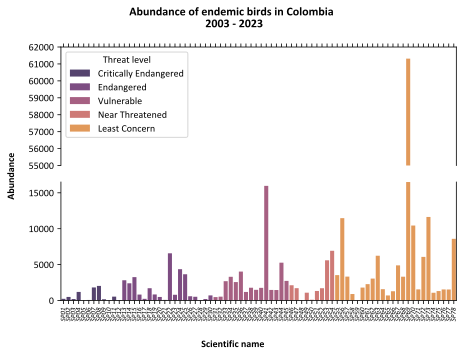

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 4/3

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear los subplots
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(ancho_columna, altura_figura))

# Ajustar el espacio entre los subplots
fig.subplots_adjust(hspace=0.05)

# Crear las dos gráficas de barras
sns.barplot(data=df_observaciones, x='codigo_sci_name', y='observation_count', hue='status_co', ax=ax1, palette=cmap_sns,edgecolor=None, alpha=0.8)
sns.barplot(data=df_observaciones, x='codigo_sci_name', y='observation_count', hue='status_co', ax=ax2, palette=cmap_sns,edgecolor=None, alpha=0.8)

# Limitar las vistas
ax1.set_ylim(55000, df_observaciones['observation_count'].max())  # solo los valores altos
ax2.set_ylim(0, 16500)  # la mayoría de los datos

# Ajustar las etiquetas del eje y en el subplot superior
ax1.set_yticks([55000, 56000, 57000, 58000, 59000, 60000, 61000, 62000])

# Ocultar las espinas entre ax1 y ax2
ax1.spines.bottom.set_visible(False)
ax2.spines.top.set_visible(False)
ax1.xaxis.tick_top()
ax1.tick_params(labeltop=False)
ax2.xaxis.tick_bottom()

# Etiquetas y personalización del gráfico
plt.xticks(rotation=90, style='italic', fontsize=7)

ax1.set_ylabel("", fontsize=12)
ax2.set_ylabel("", fontsize=12)
ax2.set_xlabel("", fontsize=12)
ax1.legend(title='Threat level', fontsize="10")
ax2.legend_.remove()  # Quitar la leyenda duplicada del segundo subplot

# Ajustar el título para que quede fuera del área de la gráfica
plt.suptitle("Abundance of endemic birds in Colombia \n 2003 - 2023", weight='bold', fontsize=12)
fig.supxlabel("Scientific name", fontsize=10, weight='bold')
fig.supylabel("Abundance", fontsize=10, weight='bold')

save_fig(ruta_figs + '00_abundancia_especies_endemicas_colombia', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '00_abundancia_especies_endemicas_colombia', tight_layout=True, fig_extension="pdf", resolution=600)
plt.show()

## **Gráfica abundancia por departamento CR, EN y VU**

In [ ]:
# Leer el archivo CSV: CR
abundancia_deps_cr = pd.read_csv(ruta_figs + '01_abundancia_deps_cr.csv', index_col = 'state_code')

# Leer el archivo CSV: EN
abundancia_deps_en = pd.read_csv(ruta_figs + '01_abundancia_deps_en.csv', index_col = 'state_code')

# Leer el archivo CSV: VU
abundancia_deps_vu = pd.read_csv(ruta_figs + '01_abundancia_deps_vu.csv', index_col = 'state_code')

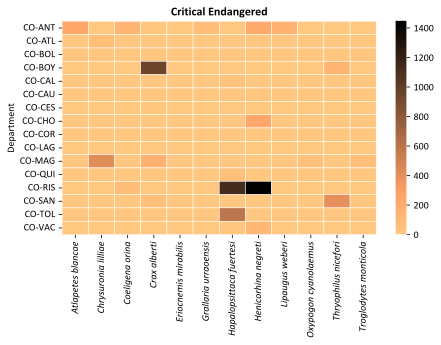

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 4/3

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Critical Endangered',weight='bold', fontsize=12)
sns.heatmap(abundancia_deps_cr, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')
ax.set_xticklabels(abundancia_deps_cr.columns,style='italic')

# plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)

save_fig(ruta_figs + '01_abundancia_departamentos_cr', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '01_abundancia_departamentos_cr', tight_layout=True, fig_extension="pdf", resolution=600)

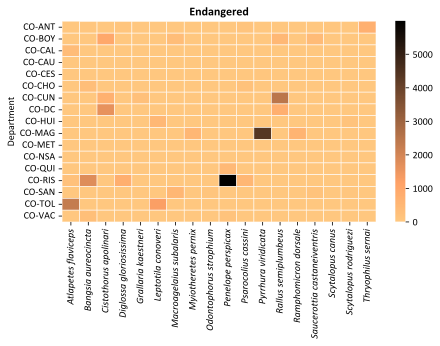

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 4/3

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Endangered',weight='bold', fontsize=12)
sns.heatmap(abundancia_deps_en, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')
ax.set_xticklabels(abundancia_deps_en.columns,style='italic')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)

save_fig(ruta_figs + '01_abundancia_departamentos_en', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '01_abundancia_departamentos_en', tight_layout=True, fig_extension="pdf", resolution=600)


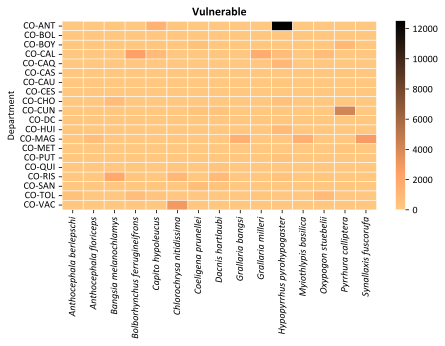

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 4/3

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Vulnerable',weight='bold', fontsize=12)
sns.heatmap(abundancia_deps_vu, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')
ax.set_xticklabels(abundancia_deps_vu.columns,style='italic')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)
save_fig(ruta_figs + '01_abundancia_departamentos_vu', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '01_abundancia_departamentos_vu', tight_layout=True, fig_extension="pdf", resolution=600)

## **Abundancia *Henicorhina negreti***

In [ ]:
# Leer el archivo CSV: CR
abundancia_hn = pd.read_csv(ruta_figs + '02_abundancia_hn.csv', index_col = 'state_code')

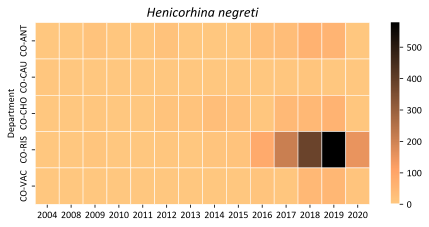

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 2/1

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Henicorhina negreti',style='italic', fontsize=14)
sns.heatmap(abundancia_hn, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)
save_fig(ruta_figs + '02_abundancia_hn', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '02_abundancia_hn', tight_layout=True, fig_extension="pdf", resolution=600)

## **Abundancia *Penelope perspicax***

In [ ]:
# Leer el archivo CSV: EN
abundancia_pp = pd.read_csv(ruta_figs + '02_abundancia_pp.csv', index_col = 'state_code')

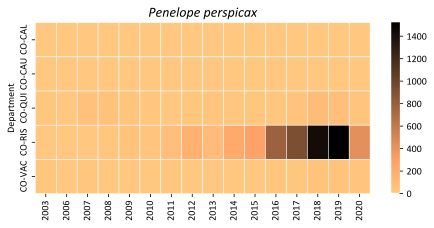

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 2/1

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Penelope perspicax',style='italic', fontsize=14)
sns.heatmap(abundancia_pp, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)
save_fig(ruta_figs + '02_abundancia_pp', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '02_abundancia_pp', tight_layout=True, fig_extension="pdf", resolution=600)

## **Abundancia *Hypopyrrhus pyrohypogaster***

In [ ]:
# Leer el archivo CSV: EN
abundancia_hp = pd.read_csv(ruta_figs + '02_abundancia_hp.csv', index_col = 'state_code')

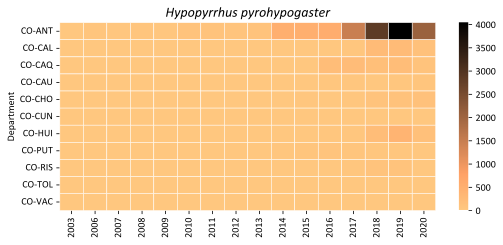

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = 2/1

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Se crean los subplots
fig, ax = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura))

# CR Level
ax.set_title('Hypopyrrhus pyrohypogaster',style='italic', fontsize=14)
sns.heatmap(abundancia_hp, cmap='copper_r', linewidths=.5, linecolor='white', ax=ax)
ax.set_ylabel('Department')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.3)
save_fig(ruta_figs + '02_abundancia_hp', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '02_abundancia_hp', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables de Esfuerzo: CR**

In [ ]:
# Leer el archivo CSV: EN
ev_cr = pd.read_csv(ruta_figs + '03_ev_correlation_cr.csv').drop(columns=['Unnamed: 0'])

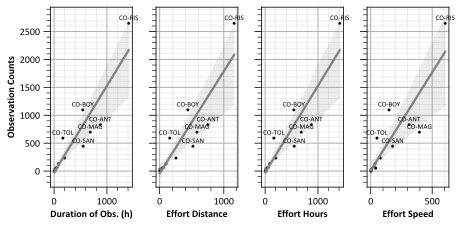

In [ ]:
# Columnas de conteo
columnas_conteo = ['duration_hours',
 'observation_count',
 'effort_distance_km',
 'effort_hours',
 'effort_speed_kmph']

# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)*2
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 4, figsize=(ancho_columna, altura_figura), sharey=True)

# Lista de combinaciones únicas de columnas para graficar
combinaciones = [('observation_count', 'duration_hours'),
                 ('observation_count', 'effort_distance_km'),
                 ('observation_count', 'effort_hours'),
                 ('observation_count', 'effort_speed_kmph')]

# Iterar sobre las combinaciones para graficar los gráficos de dispersión y mostrar las correlaciones
for i, (columna_i, columna_j) in enumerate(combinaciones):
    ax = axs[i]

    # Graficar el gráfico de dispersión
    add_grid2(sns.scatterplot(x=ev_cr[columna_j], y=ev_cr[columna_i], ax=ax, color='black', s=10))
    add_grid2(sns.regplot(x=ev_cr[columna_j], y=ev_cr[columna_i], scatter=False, ax=ax, color='gray'))


    # Nombres de los títulos según las columnas
    titulos = {
    'observation_count': 'Observation Counts',
    'duration_hours': 'Duration of Obs. (h)',
    'effort_distance_km': 'Effort Distance',
    'effort_hours': 'Effort Hours',
    'effort_speed_kmph':'Effort Speed'}

    # Obtener el nombre real de los ejes x e y
    nombre_x = titulos[columna_j]
    nombre_y = titulos[columna_i]
    ax.set_xlabel(nombre_x, fontsize=10, fontweight='bold')
    ax.set_ylabel(nombre_y, fontsize=10, fontweight='bold')

    # Añadir etiquetas de los departamentos sobre cada punto con mayor desplazamiento vertical
    for i in range(ev_cr.shape[0]):
        if ev_cr['observation_count'][i] >= 250:
            ax.text(ev_cr[columna_j][i], ev_cr['observation_count'][i] + 60, ev_cr['state_code'][i], fontsize=7, ha='center')

save_fig(ruta_figs + '03_ev_correlation_deps_cr', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '03_ev_correlation_deps_cr', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables de Esfuerzo: EN**

In [ ]:
# Leer el archivo CSV: EN
ev_en = pd.read_csv(ruta_figs + '03_ev_correlation_en.csv').drop(columns=['Unnamed: 0'])

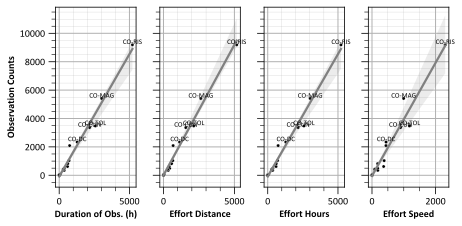

In [ ]:
# Columnas de conteo
columnas_conteo = ['duration_hours',
 'observation_count',
 'effort_distance_km',
 'effort_hours',
 'effort_speed_kmph']

# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)*2
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 4, figsize=(ancho_columna, altura_figura), sharey=True)

# Lista de combinaciones únicas de columnas para graficar
combinaciones = [('observation_count', 'duration_hours'),
                 ('observation_count', 'effort_distance_km'),
                 ('observation_count', 'effort_hours'),
                 ('observation_count', 'effort_speed_kmph')]

# Iterar sobre las combinaciones para graficar los gráficos de dispersión y mostrar las correlaciones
for i, (columna_i, columna_j) in enumerate(combinaciones):
    ax = axs[i]

    # Graficar el gráfico de dispersión
    add_grid2(sns.scatterplot(x=ev_en[columna_j], y=ev_en[columna_i], ax=ax, color='black', s=10))
    add_grid2(sns.regplot(x=ev_en[columna_j], y=ev_en[columna_i], scatter=False, ax=ax, color='gray'))


    # Nombres de los títulos según las columnas
    titulos = {
    'observation_count': 'Observation Counts',
    'duration_hours': 'Duration of Obs. (h)',
    'effort_distance_km': 'Effort Distance',
    'effort_hours': 'Effort Hours',
    'effort_speed_kmph':'Effort Speed'}

    # Obtener el nombre real de los ejes x e y
    nombre_x = titulos[columna_j]
    nombre_y = titulos[columna_i]
    ax.set_xlabel(nombre_x, fontsize=10, fontweight='bold')
    ax.set_ylabel(nombre_y, fontsize=10, fontweight='bold')

    # Añadir etiquetas de los departamentos sobre cada punto con mayor desplazamiento vertical
    top_5 = ev_en.nlargest(5, 'observation_count')
    for i in range(top_5.shape[0]):
        ax.text(top_5[columna_j].iloc[i], top_5['observation_count'].iloc[i] + 60, top_5['state_code'].iloc[i], fontsize=7, ha='center')

save_fig(ruta_figs + '03_ev_correlation_deps_en', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '03_ev_correlation_deps_en', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables de Esfuerzo: VU**

In [ ]:
# Leer el archivo CSV: VU
ev_vu = pd.read_csv(ruta_figs + '03_ev_correlation_vu.csv').drop(columns=['Unnamed: 0'])

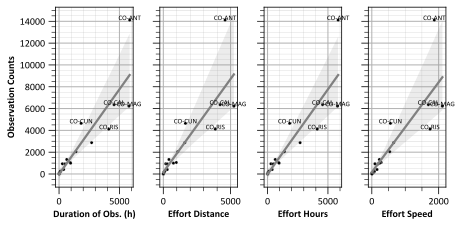

In [ ]:
# Columnas de conteo
columnas_conteo = ['duration_hours',
 'observation_count',
 'effort_distance_km',
 'effort_hours',
 'effort_speed_kmph']

# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)*2
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 4, figsize=(ancho_columna, altura_figura), sharey=True)

# Lista de combinaciones únicas de columnas para graficar
combinaciones = [('observation_count', 'duration_hours'),
                 ('observation_count', 'effort_distance_km'),
                 ('observation_count', 'effort_hours'),
                 ('observation_count', 'effort_speed_kmph')]

# Iterar sobre las combinaciones para graficar los gráficos de dispersión y mostrar las correlaciones
for i, (columna_i, columna_j) in enumerate(combinaciones):
    ax = axs[i]

    # Graficar el gráfico de dispersión
    add_grid2(sns.scatterplot(x=ev_vu[columna_j], y=ev_vu[columna_i], ax=ax, color='black', s=10))
    add_grid2(sns.regplot(x=ev_vu[columna_j], y=ev_vu[columna_i], scatter=False, ax=ax, color='gray'))


    # Nombres de los títulos según las columnas
    titulos = {
    'observation_count': 'Observation Counts',
    'duration_hours': 'Duration of Obs. (h)',
    'effort_distance_km': 'Effort Distance',
    'effort_hours': 'Effort Hours',
    'effort_speed_kmph':'Effort Speed'}

    # Obtener el nombre real de los ejes x e y
    nombre_x = titulos[columna_j]
    nombre_y = titulos[columna_i]
    ax.set_xlabel(nombre_x, fontsize=10, fontweight='bold')
    ax.set_ylabel(nombre_y, fontsize=10, fontweight='bold')

    # Añadir etiquetas de los departamentos sobre cada punto con mayor desplazamiento vertical
    top_5 = ev_vu.nlargest(5, 'observation_count')
    for i in range(top_5.shape[0]):
        ax.text(top_5[columna_j].iloc[i], top_5['observation_count'].iloc[i], top_5['state_code'].iloc[i], fontsize=7, ha='center')

save_fig(ruta_figs + '03_ev_correlation_deps_vu', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '03_ev_correlation_deps_vu', tight_layout=True, fig_extension="pdf", resolution=600)

## **Correlación de Variables de esfuerzo: CR, EN y VU**

In [ ]:
# Leer el archivo CSV: CR
ev_cr = pd.read_csv(ruta_figs + '03_ev_correlation_cr.csv').drop(columns=['Unnamed: 0'])

# Leer el archivo CSV: EN
ev_en = pd.read_csv(ruta_figs + '03_ev_correlation_en.csv').drop(columns=['Unnamed: 0'])

# Leer el archivo CSV: VU
ev_vu = pd.read_csv(ruta_figs + '03_ev_correlation_vu.csv').drop(columns=['Unnamed: 0'])

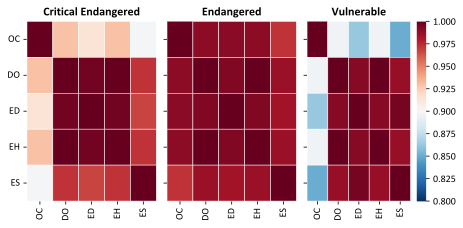

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 3, figsize=(ancho_columna, altura_figura))

# Etiquetas de los ejes
labels = ['OC','DO','ED','EH','ES']

# CR Level
num_cols_ev_cr = ev_cr[['observation_count', 'duration_hours', 'effort_distance_km', 'effort_hours', 'effort_speed_kmph']]
sns.heatmap(num_cols_ev_cr.corr(), annot=False, cmap='RdBu_r', linewidths=0.5, vmin=0.8, vmax=1.0, ax = axs[0],cbar=False)
axs[0].set_xticklabels(labels)
axs[0].set_yticklabels(labels)
axs[0].set_title('Critical Endangered', weight='bold')

# EN Level
num_cols_ev_en = ev_en[['observation_count', 'duration_hours', 'effort_distance_km', 'effort_hours', 'effort_speed_kmph']]
sns.heatmap(num_cols_ev_en.corr(), annot=False, cmap='RdBu_r', linewidths=0.5, vmin=0.8, vmax=1.0, ax = axs[1],cbar=False)
axs[1].set_xticklabels(labels)
axs[1].set_yticklabels([])
axs[1].set_title('Endangered', weight='bold')

# VU Level
num_cols_ev_vu = ev_vu[['observation_count', 'duration_hours', 'effort_distance_km', 'effort_hours', 'effort_speed_kmph']]
sns.heatmap(num_cols_ev_vu.corr(), annot=False, cmap='RdBu_r', linewidths=0.5, vmin=0.8, vmax=1.0, ax = axs[2])
axs[2].set_xticklabels(labels)
axs[2].set_yticklabels([])
axs[2].set_title('Vulnerable', weight='bold')

save_fig(ruta_figs + '03_ev_correlation_cr_en_vu', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '03_ev_correlation_cr_en_vu', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables Exógenas: MapBiomas - RISARALDA**

In [ ]:
# Raster loading
ruta_mapbiomas_ris = '/ruta/datos/MapBiomas'
lst_mb_ris = glob(os.path.join(ruta_mapbiomas_ris,"mapbiomas_ris*.tif"))
lst_mb_ris.sort()

# For visualization purposes
rasters_mb_ris = [rxr.open_rasterio(i, masked = True).squeeze() for i in lst_mb_ris]

In [ ]:
# Carga de Shape complementario
dir_Drive_shp = "/ruta/shape"
states = gpd.read_file(dir_Drive_shp)

# Region de Interés
roi = states[states['DeNombre'] == 'Risaralda']

# Reproyección a las capas de MapBiomas
roi = roi.to_crs(crs=rasters_mb_ris[0].rio.crs)

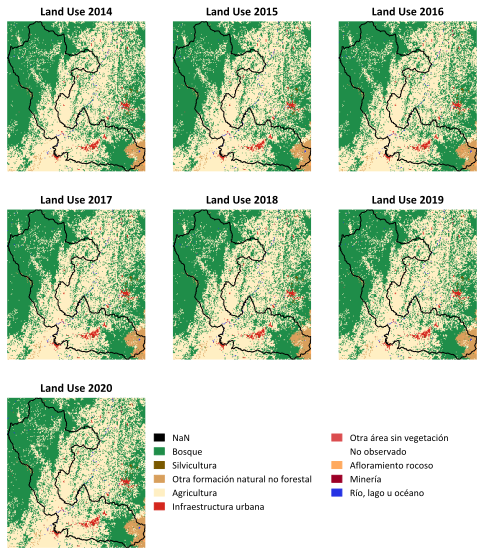

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (4/3)/2

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig = plt.figure(figsize=(ancho_columna, altura_figura))

values = [ 0., 3., 9., 13., 21., 24., 25., 27., 29., 30., 33., 34.]
colors_list = ['#000000', '#1f8d49', '#7a5900', '#d89f5c', '#ffefc3', '#d4271e',
               '#db4d4f', '#FFFFFF', '#ffaa5f', '#9c0027', '#2532e4', '#93dfe6']
labels = ['NaN', 'Bosque', 'Silvicultura', 'Otra formación natural no forestal',
          'Agricultura', 'Infraestructura urbana', 'Otra área sin vegetación',
          'No observado', 'Afloramiento rocoso', 'Minería', 'Río, lago u océano',
          'Glaciar']
years_list = [2014, 2015, 2016, 2017, 2018, 2019, 2020]

cmap = ListedColormap(colors_list) # Create a colormap (cmap) with the colors
bounds = values + [256] # Add a value to the end of the list to include the last color
norm = BoundaryNorm(bounds, cmap.N) # Normalize the colormap to the values

for i in range(len(rasters_mb_ris)):
    ax = fig.add_subplot(3,3,i+1)
    rasters_mb_ris[i].plot.imshow(ax=ax,cmap=cmap, norm=norm, add_colorbar=False)
    roi.plot(ax=ax, facecolor="none", edgecolor='black')
    ax.set_axis_off()
    ax.set_title(f'Land Use {years_list[i]}', fontsize=12, weight = 'bold')


# Legend
legend_patches = [Patch(color=colors_list[i], label=labels[i]) for i in range(len(values)-1)]

# Create the legend
plt.legend(handles = legend_patches, loc = 'center left',
          ncol = 2, fontsize = 10, handlelength=1, frameon=False, bbox_to_anchor=(1, 0.5))


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.005)

save_fig(ruta_figs + '04_lulc_ris', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '04_lulc_ris', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables Exógenas: MapBiomas - ANTIOQUIA**

In [ ]:
# Raster loading
ruta_mapbiomas_ant = '/ruta/MapBiomas'
lst_mb_ant = glob(os.path.join(ruta_mapbiomas_ant,"mapbiomas_ant*.tif"))
lst_mb_ant.sort()

# For visualization purposes
rasters_mb_ant = [rxr.open_rasterio(i, masked = True).squeeze() for i in lst_mb_ant]

In [ ]:
# Carga de Shape complementario
dir_Drive_shp = "/ruta/shape"
states = gpd.read_file(dir_Drive_shp)

# Region de Interés
roi = states[states['DeNombre'] == 'Antioquia']

# Reproyección a las capas de MapBiomas
roi = roi.to_crs(crs=rasters_mb_ant[0].rio.crs)

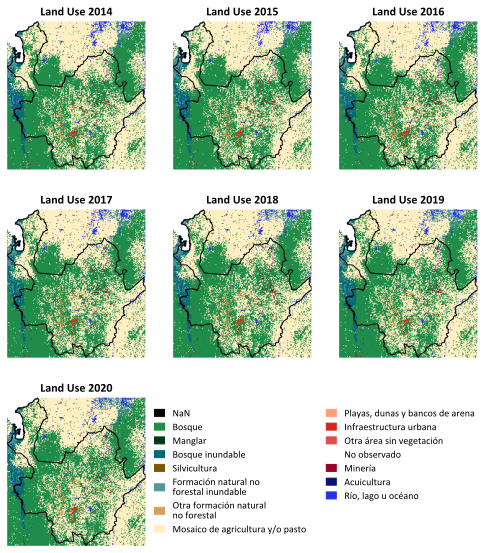

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (4/3)/2

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig = plt.figure(figsize=(ancho_columna, altura_figura))

values = [0., 3., 5., 6., 9., 11., 13., 21., 23., 24., 25., 27., 30., 31., 33., 35.]
colors_list = ['#000000', '#1f8d49', '#04381D', '#026975', '#7A5900', '#519799',
               '#D89F5C', '#FFEFC3', '#FFA07A', '#D4271E', '#DB4D4F', '#FFFFFF',
               '#9C0027', '#091077', '#2532E4', '#9065D0']
labels = ['NaN', 'Bosque', 'Manglar', 'Bosque inundable', 'Silvicultura',
          'Formación natural no\nforestal inundable', 'Otra formación natural\nno forestal',
          'Mosaico de agricultura y/o pasto', 'Playas, dunas y bancos de arena', 'Infraestructura urbana', 'Otra área sin vegetación',
          'No observado', 'Minería', 'Acuicultura', 'Río, lago u océano', 'Palma aceitera']
years_list = [2014, 2015, 2016, 2017, 2018, 2019, 2020]

cmap = ListedColormap(colors_list) # Create a colormap (cmap) with the colors
bounds = values + [256] # Add a value to the end of the list to include the last color
norm = BoundaryNorm(bounds, cmap.N) # Normalize the colormap to the values

for i in range(len(rasters_mb_ris)):
    ax = fig.add_subplot(3,3,i+1)
    rasters_mb_ant[i].plot.imshow(ax=ax,cmap=cmap, norm=norm, add_colorbar=False)
    roi.plot(ax=ax, facecolor="none", edgecolor='black')
    ax.set_axis_off()
    ax.set_title(f'Land Use {years_list[i]}', fontsize=12, weight = 'bold')


# Legend
legend_patches = [Patch(color=colors_list[i], label=labels[i]) for i in range(len(values)-1)]

# Create the legend
plt.legend(handles = legend_patches, loc = 'center left',
          ncol = 2, fontsize = 10, handlelength=1, frameon=False, bbox_to_anchor=(1, 0.5))


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.2, hspace=0.005)

save_fig(ruta_figs + '04_lulc_ant', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '04_lulc_ant', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables Exógenas: WorldClim - RISARALDA & ANTIOQUIA**

In [ ]:
# Raster loading
ruta_worldclim_ant = 'ruta/WorldClim_Output_ant/'
ruta_worldclim_ris = 'ruta/WorldClim_Output_ris/'

raster_wc_ris = rxr.open_rasterio(ruta_worldclim_ris + 'worldclim_bio_1.tif', masked = True).squeeze()
raster_wc_ant = rxr.open_rasterio(ruta_worldclim_ant + 'worldclim_bio_1.tif', masked = True).squeeze()

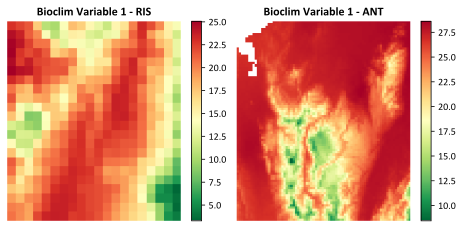

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 2, figsize=(ancho_columna, altura_figura))


# WorldClim Risaralda
raster_wc_ris.plot.imshow(ax=axs[0],cmap='RdYlGn_r', add_colorbar = True)
axs[0].set_title('Bioclim Variable 1 - RIS', weight='bold')
axs[0].set_axis_off()


# WorldClim Antioquia
raster_wc_ant.plot.imshow(ax=axs[1],cmap='RdYlGn_r')
axs[1].set_title('Bioclim Variable 1 - ANT', weight='bold')
axs[1].set_axis_off()


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.05, hspace=0.3)

save_fig(ruta_figs + '05_wc_ris_ant', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '05_wc_ris_ant', tight_layout=True, fig_extension="pdf", resolution=600)

## **Variables Exógenas: Elevacion - RISARALDA & ANTIOQUIA**

In [ ]:
# Raster loading
ruta_elev_ant = 'ruta/Elevation_Output_ant/'
ruta_elev_ris = 'ruta/Elevation_Output_ris/'

ruta_elev_ris = rxr.open_rasterio(ruta_elev_ris + 'elevation_1.tif', masked = True).squeeze()
ruta_elev_ant = rxr.open_rasterio(ruta_elev_ant + 'elevation_1.tif', masked = True).squeeze()

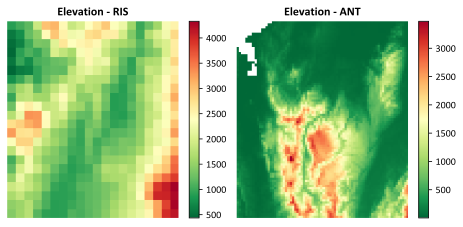

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 2, figsize=(ancho_columna, altura_figura))


# WorldClim Risaralda
ruta_elev_ris.plot.imshow(ax=axs[0],cmap='RdYlGn_r', add_colorbar = True)
axs[0].set_title('Elevation - RIS', weight='bold')
axs[0].set_axis_off()


# WorldClim Antioquia
ruta_elev_ant.plot.imshow(ax=axs[1],cmap='RdYlGn_r')
axs[1].set_title('Elevation - ANT', weight='bold')
axs[1].set_axis_off()


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.05, hspace=0.3)

save_fig(ruta_figs + '05_elev_ris_ant', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '05_elev_ris_ant', tight_layout=True, fig_extension="pdf", resolution=600)

## **Distribución Espacial Avistamientos - CR**

In [ ]:
# Ruta de los datos de avistamientos
path = "ruta/datos/avistamientos/preprocesados"

In [ ]:
# Carga de datos
df_cr =  pd.read_csv(path + 'filtered_df_final2_CR.csv',parse_dates=["last_edited_date","observation_date"])

In [ ]:
# Variables clasificadas por el tipo de dato equivalente entre Python y R

char_attributes = ["checklist_id","country","country_code","state","state_code",
                   "locality","locality_id","locality_type","observer_id",
                   "sampling_event_identifier","protocol_type","protocol_code",
                   "project_code","group_identifier","trip_comments","scientific_name",
                   "time_observations_started"]

float_attributes= ["latitude","longitude","effort_distance_km",
                   "effort_hours","effort_speed_kmph","hours_of_day","year",
                   "day_of_year"]

int_attributes  = ["duration_minutes","number_observers","observation_count"]

bool_attributes = ["all_species_reported","species_observed"]

In [ ]:
# Conversion a tipos de datos string (cadenas)
df_cr[char_attributes] = df_cr[char_attributes].astype(str)

# Conversion a tipos de datos float (flotantes)
df_cr[float_attributes] = df_cr[float_attributes].astype(float)

# Conversion a tipos de datos integer (enteros)
df_cr[int_attributes] = df_cr[int_attributes].astype(int)

# Conversion a tipos de datos boolean (booleanos)
df_cr[bool_attributes] = df_cr[bool_attributes].astype(bool)

In [ ]:
# De DataFrame a GeoDataFrame
geometry = [Point(xy) for xy in zip(df_cr['longitude'], df_cr['latitude'])]
gdf_df_cr = GeoDataFrame(df_cr, crs='WGS84', geometry=geometry)

In [ ]:
# Selección de Variables de interés a partir del GeoDataFrame de avistamientos
gdf_df_cr = gdf_df_cr[["scientific_name", "year", "latitude","longitude",
                       "observation_count", "geometry","effort_hours",'effort_speed_kmph',
                       'effort_distance_km', 'number_observers']]

In [ ]:
# Se transforman los datos a una representacion basada en Unidades Estándar
gdf_df_cr = gdf_df_cr.to_crs(epsg = 5382)

In [ ]:
# Carga de Shape complementario
dir_Drive_shp = "ruta/shape"
gpd_cr = gpd.read_file(dir_Drive_shp)

# Region de Interés
roi = states[states['DeNombre'] == 'Risaralda']

# Reproyección a las capas de MapBiomas
roi = roi.to_crs(crs=gdf_df_cr.crs)

In [ ]:
# A partir del shape de la Región de Interés se genera una malla hexagonal
roi_hexagrid = ghg.make_grid_from_gdf(roi, R=500)

In [ ]:
# Recorte del shape
roi_hexagrid = gpd.clip(roi_hexagrid,roi)

In [ ]:
# Etiquetas para graficar
gdf_df_cr['label'] = gdf_df_cr['observation_count'].apply(lambda x: 'Presence' if x > 0 else 'Abscense')

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (4/3)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura), sharey=True, sharex=True)

roi_hexagrid.plot(ax=axs,facecolor='black',linewidth=1.5,alpha=0.8)
gdf_df_cr.plot(ax=axs,markersize=2, column = 'label', cmap = 'bwr', categorical=True, legend= True, legend_kwds={'loc': 'lower left'})
cx.add_basemap(ax=axs,crs=roi_hexagrid.crs,attribution_size=3)

axs.add_artist(ScaleBar(1))

plt.title("Spatial Distribution CR Level - RIS", fontsize=12, weight = 'bold')
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.05, hspace=0.3)

save_fig(ruta_figs + '06_distribucion_malla_ris_cr', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '06_distribucion_malla_ris_cr', tight_layout=True, fig_extension="pdf", resolution=600)

## **Distribución Espacial Avistamientos - EN**

In [ ]:
# Ruta de los datos de avistamientos
path = "ruta/datos"

In [ ]:
# Carga de datos
df_en =  pd.read_csv(path + 'filtered_df_final2_EN.csv',parse_dates=["last_edited_date","observation_date"])

In [ ]:
# Variables clasificadas por el tipo de dato equivalente entre Python y R

char_attributes = ["checklist_id","country","country_code","state","state_code",
                   "locality","locality_id","locality_type","observer_id",
                   "sampling_event_identifier","protocol_type","protocol_code",
                   "project_code","group_identifier","trip_comments","scientific_name",
                   "time_observations_started"]

float_attributes= ["latitude","longitude","effort_distance_km",
                   "effort_hours","effort_speed_kmph","hours_of_day","year",
                   "day_of_year"]

int_attributes  = ["duration_minutes","number_observers","observation_count"]

bool_attributes = ["all_species_reported","species_observed"]

In [ ]:
# Conversion a tipos de datos string (cadenas)
df_en[char_attributes] = df_en[char_attributes].astype(str)

# Conversion a tipos de datos float (flotantes)
df_en[float_attributes] = df_en[float_attributes].astype(float)

# Conversion a tipos de datos integer (enteros)
df_en[int_attributes] = df_en[int_attributes].astype(int)

# Conversion a tipos de datos boolean (booleanos)
df_en[bool_attributes] = df_en[bool_attributes].astype(bool)

In [ ]:
# De DataFrame a GeoDataFrame
geometry = [Point(xy) for xy in zip(df_en['longitude'], df_en['latitude'])]
gdf_df_en = GeoDataFrame(df_en, crs='WGS84', geometry=geometry)

In [ ]:
# Selección de Variables de interés a partir del GeoDataFrame de avistamientos
gdf_df_en = gdf_df_en[["scientific_name", "year", "latitude","longitude",
                       "observation_count", "geometry","effort_hours",'effort_speed_kmph',
                       'effort_distance_km', 'number_observers']]

In [ ]:
# Se transforman los datos a una representacion basada en Unidades Estándar
gdf_df_en = gdf_df_en.to_crs(epsg = 5382)

In [ ]:
# Carga de Shape complementario
dir_Drive_shp = "ruta/shape"
gpd_en = gpd.read_file(dir_Drive_shp)

# Region de Interés
roi = states[states['DeNombre'] == 'Risaralda']

# Reproyección a las capas de MapBiomas
roi = roi.to_crs(crs=gdf_df_en.crs)

In [ ]:
# A partir del shape de la Región de Interés se genera una malla hexagonal
roi_hexagrid = ghg.make_grid_from_gdf(roi, R=500)

In [ ]:
# Recorte del shape
roi_hexagrid = gpd.clip(roi_hexagrid,roi)

In [ ]:
# Etiquetas para graficar
gdf_df_en['label'] = gdf_df_en['observation_count'].apply(lambda x: 'Presence' if x > 0 else 'Abscense')

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (4/3)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura), sharey=True, sharex=True)

roi_hexagrid.plot(ax=axs,facecolor='black',linewidth=1.5,alpha=0.8)
gdf_df_en.plot(ax=axs,markersize=2, column = 'label', cmap = 'bwr', categorical=True, legend= True, legend_kwds={'loc': 'lower left'})
cx.add_basemap(ax=axs,crs=roi_hexagrid.crs,attribution_size=3)

axs.add_artist(ScaleBar(1))

plt.title("Spatial Distribution EN Level - RIS", fontsize=12, weight = 'bold')
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.05, hspace=0.3)

save_fig(ruta_figs + '06_distribucion_malla_ris_en', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '06_distribucion_malla_ris_en', tight_layout=True, fig_extension="pdf", resolution=600)

## **Distribución Espacial Avistamientos - VU**

In [ ]:
# Ruta de los datos de avistamientos
path = "ruta/datos"

In [ ]:
# Carga de datos
df_vu =  pd.read_csv(path + 'filtered_df_final2_VU.csv',parse_dates=["last_edited_date","observation_date"])

In [ ]:
# Variables clasificadas por el tipo de dato equivalente entre Python y R

char_attributes = ["checklist_id","country","country_code","state","state_code",
                   "locality","locality_id","locality_type","observer_id",
                   "sampling_event_identifier","protocol_type","protocol_code",
                   "project_code","group_identifier","trip_comments","scientific_name",
                   "time_observations_started"]

float_attributes= ["latitude","longitude","effort_distance_km",
                   "effort_hours","effort_speed_kmph","hours_of_day","year",
                   "day_of_year"]

int_attributes  = ["duration_minutes","number_observers","observation_count"]

bool_attributes = ["all_species_reported","species_observed"]

In [ ]:
# Conversion a tipos de datos string (cadenas)
df_vu[char_attributes] = df_vu[char_attributes].astype(str)

# Conversion a tipos de datos float (flotantes)
df_vu[float_attributes] = df_vu[float_attributes].astype(float)

# Conversion a tipos de datos integer (enteros)
df_vu[int_attributes] = df_vu[int_attributes].astype(int)

# Conversion a tipos de datos boolean (booleanos)
df_vu[bool_attributes] = df_vu[bool_attributes].astype(bool)

In [ ]:
# De DataFrame a GeoDataFrame
geometry = [Point(xy) for xy in zip(df_vu['longitude'], df_vu['latitude'])]
gdf_df_vu = GeoDataFrame(df_vu, crs='WGS84', geometry=geometry)

In [ ]:
# Selección de Variables de interés a partir del GeoDataFrame de avistamientos
gdf_df_vu = gdf_df_vu[["scientific_name", "year", "latitude","longitude",
                       "observation_count", "geometry","effort_hours",'effort_speed_kmph',
                       'effort_distance_km', 'number_observers']]

In [ ]:
# Se transforman los datos a una representacion basada en Unidades Estándar
gdf_df_vu = gdf_df_vu.to_crs(epsg = 5382)

In [ ]:
# Carga de Shape complementario
dir_Drive_shp = "ruta/shape"
gpd_vu = gpd.read_file(dir_Drive_shp)

# Region de Interés
roi = states[states['DeNombre'] == 'Antioquia']

# Reproyección a las capas de MapBiomas
roi = roi.to_crs(crs=gdf_df_vu.crs)

In [ ]:
# A partir del shape de la Región de Interés se genera una malla hexagonal
roi_hexagrid = ghg.make_grid_from_gdf(roi, R=2000)

In [ ]:
# Recorte del shape
roi_hexagrid = gpd.clip(roi_hexagrid,roi)

In [ ]:
# Etiquetas para graficar
gdf_df_vu['label'] = gdf_df_vu['observation_count'].apply(lambda x: 'Presence' if x > 0 else 'Abscense')

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
aspect_ratio = (4/3)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 1, figsize=(ancho_columna, altura_figura), sharey=True, sharex=True)

roi_hexagrid.plot(ax=axs,facecolor='black',linewidth=1.5,alpha=0.8)
gdf_df_vu.plot(ax=axs,markersize=2, column = 'label', cmap = 'bwr', categorical=True, legend= True, legend_kwds={'loc': 'lower left'})
cx.add_basemap(ax=axs,crs=roi_hexagrid.crs,attribution_size=3)

axs.add_artist(ScaleBar(1))

plt.title("Spatial Distribution VU Level - ANT", fontsize=12, weight = 'bold')
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.05, hspace=0.3)

save_fig(ruta_figs + '06_distribucion_malla_ant_vu', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '06_distribucion_malla_ant_vu', tight_layout=True, fig_extension="pdf", resolution=600)

## **Correlación Variables Exógenas - CR**

In [ ]:
# Se cargan los datos del GeoDataFrame
path = "ruta/shape"

gdf_mb_ev_elv_wc_cr = gpd.read_file(path)

In [ ]:
# Se cargan las descripciones de MapBiomas Colombia
path = "ruta/leyendas/MapBiomas/Colombia"

df_mb_legends = pd.read_csv(path, delimiter=';')

In [ ]:
# Se renombran las variables
keys = gdf_mb_ev_elv_wc_cr.columns.to_list()
values = ['cell_id','observation_count', 'effort_speed_kmph','effort_hours',
          'effort_distance_km','number_observers', 'label','elevation',
          'anual_mean_t', 'mean_diurnal_range','isothermality', 't_seasonality',
          'max_t_warmest_month', 'min_t_coldest_month', 't_annual_range',
          'mean_t_wettest_q', 'mean_t_driest_q','mean_t_warmest_q','mean_t_coldest_q',
          'annual_p', 'p_wettest_m','p_driest_m', 'p_seasonality', 'p_wettest_q',
          'p_driest_q', 'p_warmest_q', 'p_coldest_q','index_right', 'lulc_2014',
          'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018', 'lulc_2019',
          'lulc_2020', 'geometry']

gdf_mb_ev_elv_wc_cr.rename(columns=dict(zip(keys, values)),inplace=True)

In [ ]:
# Se convierten las columnas que tomaron los datos como cadenas de caracteres a
# números
columnas_strings = ['elevation','anual_mean_t', 'mean_diurnal_range','isothermality',
                    't_seasonality', 'max_t_warmest_month', 'min_t_coldest_month',
                    't_annual_range', 'mean_t_wettest_q', 'mean_t_driest_q',
                    'mean_t_warmest_q','mean_t_coldest_q','annual_p', 'p_wettest_m',
                    'p_driest_m', 'p_seasonality', 'p_wettest_q','p_driest_q',
                    'p_warmest_q', 'p_coldest_q']

gdf_mb_ev_elv_wc_cr[columnas_strings] = gdf_mb_ev_elv_wc_cr[columnas_strings].astype(float)

# Se convierten las columnas de MapBiomas a enteros
columnas_ints = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
                 'lulc_2019', 'lulc_2020']

gdf_mb_ev_elv_wc_cr[columnas_ints] = gdf_mb_ev_elv_wc_cr[columnas_ints].astype(int)

In [ ]:
# Las variables de uso y cobertura de suelo son categóricas, por lo que conviene
# convertirlas a cadenas de texto y luego generar la codificación dummy. Primero
# a cadena de texto:
lulc_list = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
             'lulc_2019', 'lulc_2020']

for lulc_year in lulc_list:
    keys = list(gdf_mb_ev_elv_wc_cr[lulc_year].unique())
    values = df_mb_legends[df_mb_legends['id'].isin(keys)]['clases']
    gdf_mb_ev_elv_wc_cr[lulc_year].replace(dict(zip(keys,values)), inplace=True)

gdf_mb_ev_elv_wc_cr

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,p_coldest_q,index_right,lulc_2014,lulc_2015,lulc_2016,lulc_2017,lulc_2018,lulc_2019,lulc_2020,geometry
0,"-2098,24366",0.0,0.000,0.0,0.00,0.0,0,4294.0,3.497833,8.543000,...,268.0,0,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-75.3791 4.72945)
1,"-2098,24374",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,1,bosque,bosque,bosque,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,POINT (-75.3794 4.76105)
2,"-2098,24376",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,2,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,POINT (-75.37983 4.76657)
3,"-2098,24378",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,3,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,POINT (-75.37998 4.77227)
4,"-2098,24380",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,4,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,bosque,POINT (-75.37935 4.78099)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6480,"-2224,24542",0.0,1.575,6.4,4.13,15.0,0,435.0,25.054001,9.688666,...,1175.0,6481,mosaico_de_agricultura_pasto,mosaico_de_agricultura_pasto,mosaico_de_agricultura_pasto,mineria,rio_lago_oceano,otra_formacion_natural_no_forestal,infraestructura_urbana,POINT (-76.20093 5.35628)
6481,"-2224,24544",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6482,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20126 5.36429)
6482,"-2224,24546",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6483,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20088 5.36786)
6483,"-2225,24539",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6484,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20753 5.34678)


In [ ]:
# Ahora los dummy para cada categoría de uso de suelo por año
gdf_mb_ev_elv_wc_cr = pd.concat([
    gdf_mb_ev_elv_wc_cr.drop(columns = lulc_list),
    pd.get_dummies(gdf_mb_ev_elv_wc_cr[lulc_list], dtype=float)
], axis = 1)

gdf_mb_ev_elv_wc_cr.head()

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,lulc_2019_otra_formacion_natural_no_forestal,lulc_2019_rio_lago_oceano,lulc_2020_afloramiento_rocoso,lulc_2020_bosque,lulc_2020_infraestructura_urbana,lulc_2020_mineria,lulc_2020_mosaico_de_agricultura_pasto,lulc_2020_otra_area_sin_vegetacion,lulc_2020_otra_formacion_natural_no_forestal,lulc_2020_rio_lago_oceano
0,"-2098,24366",0.0,0.0,0.0,0.0,0.0,0,4294.0,3.497833,8.543000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,"-2098,24374",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,"-2098,24376",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,"-2098,24378",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,"-2098,24380",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Declaremos las columnas que son únicamente numéricas
columnas_no_interes = ['cell_id','label','index_right','observation_count','geometry']
variables_exogenas = gdf_mb_ev_elv_wc_cr.drop(columns=columnas_no_interes).columns.to_list()

In [ ]:
# Correlacion CR Variables Completas
ev_cr = gdf_mb_ev_elv_wc_cr[variables_exogenas]
ev_cr = ev_cr.corr()

In [ ]:
# Correlacion CR - VIF
cr_variables_vif = ['number_observers','lulc_2014_bosque','lulc_2014_mineria',
                    'lulc_2014_otra_area_sin_vegetacion', 'lulc_2014_rio_lago_oceano',
                    'lulc_2016_bosque', 'lulc_2017_bosque', 'lulc_2017_mosaico_de_agricultura_pasto',
                    'lulc_2018_mosaico_de_agricultura_pasto', 'lulc_2018_otra_formacion_natural_no_forestal',
                    'lulc_2018_rio_lago_oceano', 'lulc_2019_otra_area_sin_vegetacion',
                    'lulc_2020_afloramiento_rocoso', 'lulc_2020_otra_area_sin_vegetacion',
                    'lulc_2020_otra_formacion_natural_no_forestal', 'lulc_2020_rio_lago_oceano']
ev_cr_vif = gdf_mb_ev_elv_wc_cr[cr_variables_vif]
ev_cr_vif = ev_cr_vif.corr()

In [ ]:
# Se renombran columnas y filas de las matrices de correlacion
# Etiquetas de los ejes
labels_ev_cr = generar_siglas(variables_exogenas)
labels_ev_cr_vif = generar_siglas(cr_variables_vif)

# Se renombran variables completas
ev_cr.columns = [*labels_ev_cr.values()]
ev_cr.index = [*labels_ev_cr.values()]

# Se renombran variables seleccionadas por VIF
ev_cr_vif.columns = [*labels_ev_cr_vif.values()]
ev_cr_vif.index = [*labels_ev_cr_vif.values()]

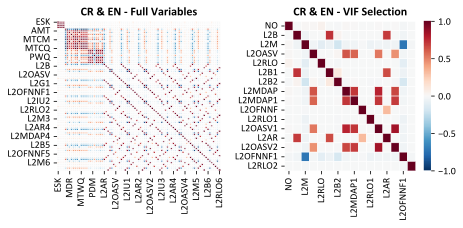

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 2, figsize=(ancho_columna, altura_figura))

# CR Level
sns.heatmap(ev_cr, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[0],cbar=False)
axs[0].set_title('CR & EN - Full Variables', weight='bold')

# CR Level - VIF
sns.heatmap(ev_cr_vif, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[1],cbar=True)
axs[1].set_title('CR & EN - VIF Selection', weight='bold')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.3, hspace=0.3)

save_fig(ruta_figs + '07_correlation_var_exo_cr', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '07_correlation_var_exo_cr', tight_layout=True, fig_extension="pdf", resolution=600)

## **Correlación Variables Exógenas - EN**

In [ ]:
# Se cargan los datos del GeoDataFrame
path = "ruta/shape"

gdf_mb_ev_elv_wc_en = gpd.read_file(path)

In [ ]:
# Se cargan las descripciones de MapBiomas Colombia
path = "ruta/leyendas/MapBiomas/Colombia"

df_mb_legends = pd.read_csv(path, delimiter=';')

In [ ]:
# Se renombran las variables
keys = gdf_mb_ev_elv_wc_en.columns.to_list()
values = ['cell_id','observation_count', 'effort_speed_kmph','effort_hours',
          'effort_distance_km','number_observers', 'label','elevation',
          'anual_mean_t', 'mean_diurnal_range','isothermality', 't_seasonality',
          'max_t_warmest_month', 'min_t_coldest_month', 't_annual_range',
          'mean_t_wettest_q', 'mean_t_driest_q','mean_t_warmest_q','mean_t_coldest_q',
          'annual_p', 'p_wettest_m','p_driest_m', 'p_seasonality', 'p_wettest_q',
          'p_driest_q', 'p_warmest_q', 'p_coldest_q','index_right', 'lulc_2014',
          'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018', 'lulc_2019',
          'lulc_2020', 'geometry']

gdf_mb_ev_elv_wc_en.rename(columns=dict(zip(keys, values)),inplace=True)

In [ ]:
# Se convierten las columnas que tomaron los datos como cadenas de caracteres a
# números
columnas_strings = ['elevation','anual_mean_t', 'mean_diurnal_range','isothermality',
                    't_seasonality', 'max_t_warmest_month', 'min_t_coldest_month',
                    't_annual_range', 'mean_t_wettest_q', 'mean_t_driest_q',
                    'mean_t_warmest_q','mean_t_coldest_q','annual_p', 'p_wettest_m',
                    'p_driest_m', 'p_seasonality', 'p_wettest_q','p_driest_q',
                    'p_warmest_q', 'p_coldest_q']

gdf_mb_ev_elv_wc_en[columnas_strings] = gdf_mb_ev_elv_wc_en[columnas_strings].astype(float)

# Se convierten las columnas de MapBiomas a enteros
columnas_ints = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
                 'lulc_2019', 'lulc_2020']

gdf_mb_ev_elv_wc_en[columnas_ints] = gdf_mb_ev_elv_wc_en[columnas_ints].astype(int)

In [ ]:
# Las variables de uso y cobertura de suelo son categóricas, por lo que conviene
# convertirlas a cadenas de texto y luego generar la codificación dummy. Primero
# a cadena de texto:
lulc_list = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
             'lulc_2019', 'lulc_2020']

for lulc_year in lulc_list:
    keys = list(gdf_mb_ev_elv_wc_en[lulc_year].unique())
    values = df_mb_legends[df_mb_legends['id'].isin(keys)]['clases']
    gdf_mb_ev_elv_wc_en[lulc_year].replace(dict(zip(keys,values)), inplace=True)

gdf_mb_ev_elv_wc_en

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,p_coldest_q,index_right,lulc_2014,lulc_2015,lulc_2016,lulc_2017,lulc_2018,lulc_2019,lulc_2020,geometry
0,"-2098,24366",0.0,0.000,0.0,0.00,0.0,0,4294.0,3.497833,8.543000,...,268.0,0,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-75.3791 4.72945)
1,"-2098,24374",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,1,bosque,bosque,bosque,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,POINT (-75.3794 4.76105)
2,"-2098,24376",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,2,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,POINT (-75.37983 4.76657)
3,"-2098,24378",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,3,afloramiento_rocoso,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,POINT (-75.37998 4.77227)
4,"-2098,24380",0.0,0.000,0.0,0.00,0.0,0,4249.0,3.748000,8.762667,...,279.0,4,afloramiento_rocoso,afloramiento_rocoso,bosque,bosque,bosque,bosque,bosque,POINT (-75.37935 4.78099)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6480,"-2224,24542",0.0,1.575,6.4,4.13,15.0,0,435.0,25.054001,9.688666,...,1175.0,6481,mosaico_de_agricultura_pasto,mosaico_de_agricultura_pasto,mosaico_de_agricultura_pasto,mineria,rio_lago_oceano,otra_formacion_natural_no_forestal,infraestructura_urbana,POINT (-76.20093 5.35628)
6481,"-2224,24544",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6482,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20126 5.36429)
6482,"-2224,24546",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6483,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20088 5.36786)
6483,"-2225,24539",0.0,0.000,0.0,0.00,0.0,0,435.0,25.054001,9.688666,...,1175.0,6484,mineria,mineria,mineria,otra_area_sin_vegetacion,mineria,infraestructura_urbana,infraestructura_urbana,POINT (-76.20753 5.34678)


In [ ]:
# Ahora los dummy para cada categoría de uso de suelo por año
gdf_mb_ev_elv_wc_en = pd.concat([
    gdf_mb_ev_elv_wc_en.drop(columns = lulc_list),
    pd.get_dummies(gdf_mb_ev_elv_wc_en[lulc_list], dtype=float)
], axis = 1)

gdf_mb_ev_elv_wc_en.head()

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,lulc_2019_otra_formacion_natural_no_forestal,lulc_2019_rio_lago_oceano,lulc_2020_afloramiento_rocoso,lulc_2020_bosque,lulc_2020_infraestructura_urbana,lulc_2020_mineria,lulc_2020_mosaico_de_agricultura_pasto,lulc_2020_otra_area_sin_vegetacion,lulc_2020_otra_formacion_natural_no_forestal,lulc_2020_rio_lago_oceano
0,"-2098,24366",0.0,0.0,0.0,0.0,0.0,0,4294.0,3.497833,8.543000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,"-2098,24374",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,"-2098,24376",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,"-2098,24378",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,"-2098,24380",0.0,0.0,0.0,0.0,0.0,0,4249.0,3.748000,8.762667,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Declaremos las columnas que son únicamente numéricas
columnas_no_interes = ['observation_count','cell_id','label','index_right','geometry']
variables_exogenas = gdf_mb_ev_elv_wc_en.drop(columns=columnas_no_interes).columns.to_list()

In [ ]:
# Correlacion EN Variables Completas
ev_en = gdf_mb_ev_elv_wc_en[variables_exogenas]
ev_en = ev_en.corr()

In [ ]:
# Correlacion CR - VIF
en_variables_vif = ['number_observers','lulc_2014_bosque','lulc_2014_mineria',
                    'lulc_2014_otra_area_sin_vegetacion', 'lulc_2014_rio_lago_oceano',
                    'lulc_2016_bosque', 'lulc_2017_bosque', 'lulc_2017_mosaico_de_agricultura_pasto',
                    'lulc_2018_mosaico_de_agricultura_pasto', 'lulc_2018_otra_formacion_natural_no_forestal',
                    'lulc_2018_rio_lago_oceano', 'lulc_2019_otra_area_sin_vegetacion',
                    'lulc_2020_afloramiento_rocoso', 'lulc_2020_otra_area_sin_vegetacion',
                    'lulc_2020_otra_formacion_natural_no_forestal', 'lulc_2020_rio_lago_oceano']
ev_en_vif = gdf_mb_ev_elv_wc_en[en_variables_vif]
ev_en_vif = ev_en_vif.corr()

In [ ]:
# Se renombran columnas y filas de las matrices de correlacion
# Etiquetas de los ejes
labels_ev_en = generar_siglas(variables_exogenas)
labels_ev_en_vif = generar_siglas(en_variables_vif)

# Se renombran variables completas
ev_en.columns = [*labels_ev_en.values()]
ev_en.index = [*labels_ev_en.values()]

# Se renombran variables seleccionadas por VIF
ev_en_vif.columns = [*labels_ev_en_vif.values()]
ev_en_vif.index = [*labels_ev_en_vif.values()]

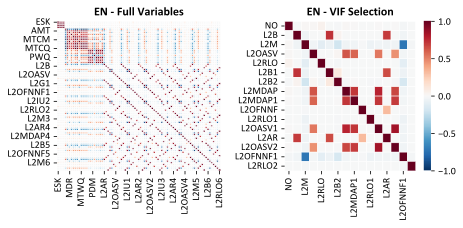

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 2, figsize=(ancho_columna, altura_figura))

# EN Level
sns.heatmap(ev_en, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[0],cbar=False)
axs[0].set_title('EN - Full Variables', weight='bold')

# EN Level - VIF
sns.heatmap(ev_en_vif, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[1],cbar=True)
axs[1].set_title('EN - VIF Selection', weight='bold')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.3, hspace=0.3)

save_fig(ruta_figs + '07_correlation_var_exo_en', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '07_correlation_var_exo_en', tight_layout=True, fig_extension="pdf", resolution=600)

## **Correlación Variables Exógenas - VU**

In [ ]:
# Se cargan los datos del GeoDataFrame
path = "ruta/shape"

gdf_mb_ev_elv_wc_vu = gpd.read_file(path)

In [ ]:
# Se cargan las descripciones de MapBiomas Colombia
path = "ruta/leyendas/MapBiomas/Colombia"

df_mb_legends = pd.read_csv(path, delimiter=';')

In [ ]:
# Se renombran las variables
keys = gdf_mb_ev_elv_wc_vu.columns.to_list()
values = ['cell_id','observation_count', 'effort_speed_kmph','effort_hours',
          'effort_distance_km','number_observers', 'label','elevation',
          'anual_mean_t', 'mean_diurnal_range','isothermality', 't_seasonality',
          'max_t_warmest_month', 'min_t_coldest_month', 't_annual_range',
          'mean_t_wettest_q', 'mean_t_driest_q','mean_t_warmest_q','mean_t_coldest_q',
          'annual_p', 'p_wettest_m','p_driest_m', 'p_seasonality', 'p_wettest_q',
          'p_driest_q', 'p_warmest_q', 'p_coldest_q','index_right', 'lulc_2014',
          'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018', 'lulc_2019',
          'lulc_2020', 'geometry']

gdf_mb_ev_elv_wc_vu.rename(columns=dict(zip(keys, values)),inplace=True)

In [ ]:
# Se convierten las columnas que tomaron los datos como cadenas de caracteres a
# números
columnas_strings = ['elevation','anual_mean_t', 'mean_diurnal_range','isothermality',
                    't_seasonality', 'max_t_warmest_month', 'min_t_coldest_month',
                    't_annual_range', 'mean_t_wettest_q', 'mean_t_driest_q',
                    'mean_t_warmest_q','mean_t_coldest_q','annual_p', 'p_wettest_m',
                    'p_driest_m', 'p_seasonality', 'p_wettest_q','p_driest_q',
                    'p_warmest_q', 'p_coldest_q']

gdf_mb_ev_elv_wc_vu[columnas_strings] = gdf_mb_ev_elv_wc_vu[columnas_strings].astype(float)

# Se convierten las columnas de MapBiomas a enteros
columnas_ints = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
                 'lulc_2019', 'lulc_2020']

gdf_mb_ev_elv_wc_vu[columnas_ints] = gdf_mb_ev_elv_wc_vu[columnas_ints].astype(int)

In [ ]:
# Las variables de uso y cobertura de suelo son categóricas, por lo que conviene
# convertirlas a cadenas de texto y luego generar la codificación dummy. Primero
# a cadena de texto:
lulc_list = ['lulc_2014', 'lulc_2015', 'lulc_2016', 'lulc_2017', 'lulc_2018',
             'lulc_2019', 'lulc_2020']

for lulc_year in lulc_list:
    keys = list(gdf_mb_ev_elv_wc_vu[lulc_year].unique())
    values = df_mb_legends[df_mb_legends['id'].isin(keys)]['clases']
    gdf_mb_ev_elv_wc_vu[lulc_year].replace(dict(zip(keys,values)), inplace=True)

gdf_mb_ev_elv_wc_vu

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,p_coldest_q,index_right,lulc_2014,lulc_2015,lulc_2016,lulc_2017,lulc_2018,lulc_2019,lulc_2020,geometry
0,"-464,6240",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.112501,10.981667,...,967.0,0,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-73.8933 7.00063)
1,"-464,6242",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.112501,10.981667,...,967.0,1,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-73.89155 7.02506)
2,"-464,6244",0.0,1.250000,4.183333,5.00,3.0,0,71.0,28.192833,11.117667,...,968.0,2,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-73.89433 7.05521)
3,"-464,6246",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.192833,11.117667,...,968.0,3,manglar,manglar,manglar,manglar,manglar,manglar,manglar,POINT (-73.89736 7.07805)
4,"-465,6239",0.0,8.185726,8.633333,13.99,11.0,0,75.0,28.035999,10.820666,...,926.0,4,bosque,bosque,bosque,bosque,bosque,bosque,bosque,POINT (-73.91399 6.98307)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7117,"-587,6303",0.0,0.000000,0.000000,0.00,0.0,0,4.0,27.132500,7.939667,...,828.0,7117,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,otra_formacion_natural_no_forestal,POINT (-77.09574 7.79475)
7118,"-587,6305",0.0,0.000000,0.000000,0.00,0.0,0,4.0,27.132500,7.939667,...,828.0,7118,no_observado,playas_dunas_bancos_de_arena,mineria,mosaico_de_agricultura_pasto,mosaico_de_agricultura_pasto,infraestructura_urbana,formacion_natural_no_forestal_inundable,POINT (-77.09588 7.81951)
7119,"-588,6302",0.0,1.140000,0.166667,0.19,3.0,0,3.0,27.167334,7.989333,...,864.0,7119,rio_lago_oceano,rio_lago_oceano,no_observado,rio_lago_oceano,rio_lago_oceano,rio_lago_oceano,no_observado,POINT (-77.11322 7.78612)
7120,"-588,6304",0.0,11.053846,0.383333,2.35,6.0,0,4.0,27.132500,7.939667,...,828.0,7120,bosque,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,formacion_natural_no_forestal_inundable,otra_formacion_natural_no_forestal,POINT (-77.11676 7.80881)


In [ ]:
# Ahora los dummy para cada categoría de uso de suelo por año
gdf_mb_ev_elv_wc_vu = pd.concat([
    gdf_mb_ev_elv_wc_vu.drop(columns = lulc_list),
    pd.get_dummies(gdf_mb_ev_elv_wc_vu[lulc_list], dtype=float)
], axis = 1)

gdf_mb_ev_elv_wc_vu.head()

,cell_id,observation_count,effort_speed_kmph,effort_hours,effort_distance_km,number_observers,label,elevation,anual_mean_t,mean_diurnal_range,...,lulc_2020_infraestructura_urbana,lulc_2020_manglar,lulc_2020_mineria,lulc_2020_mosaico_de_agricultura_pasto,lulc_2020_no_observado,lulc_2020_otra_area_sin_vegetacion,lulc_2020_otra_formacion_natural_no_forestal,lulc_2020_palma_aceitera,lulc_2020_rio_lago_oceano,lulc_2020_silvicultura
0,"-464,6240",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.112501,10.981667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,"-464,6242",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.112501,10.981667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,"-464,6244",0.0,1.250000,4.183333,5.00,3.0,0,71.0,28.192833,11.117667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,"-464,6246",0.0,0.000000,0.000000,0.00,0.0,0,71.0,28.192833,11.117667,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,"-465,6239",0.0,8.185726,8.633333,13.99,11.0,0,75.0,28.035999,10.820666,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Declaremos las columnas que son únicamente numéricas
columnas_no_interes = ['observation_count','cell_id','label','index_right','geometry']
variables_exogenas = gdf_mb_ev_elv_wc_vu.drop(columns=columnas_no_interes).columns.to_list()

In [ ]:
# Correlacion EN Variables Completas
ev_vu = gdf_mb_ev_elv_wc_vu[variables_exogenas]
ev_vu = ev_vu.corr()

In [ ]:
# Correlacion CR - VIF
vu_variables_vif = ['effort_speed_kmph', 'number_observers', 'elevation',
                    'p_driest_m', 'lulc_2014_formacion_natural_no_forestal_inundable',
                    'lulc_2014_manglar', 'lulc_2014_mineria', 'lulc_2014_mosaico_de_agricultura_pasto',
                    'lulc_2014_no_observado', 'lulc_2014_otra_area_sin_vegetacion',
                    'lulc_2014_otra_formacion_natural_no_forestal',
                    'lulc_2014_playas_dunas_bancos_de_arena', 'lulc_2014_silvicultura',
                    'lulc_2015_mosaico_de_agricultura_pasto',
                    'lulc_2016_otra_formacion_natural_no_forestal',
                    'lulc_2017_bosque_inundable', 'lulc_2017_playas_dunas_bancos_de_arena',
                    'lulc_2017_silvicultura', 'lulc_2018_infraestructura_urbana',
                    'lulc_2018_otra_formacion_natural_no_forestal', 'lulc_2018_silvicultura',
                    'lulc_2019_mosaico_de_agricultura_pasto', 'lulc_2019_no_observado',
                    'lulc_2019_otra_formacion_natural_no_forestal', 'lulc_2019_palma_aceitera',
                    'lulc_2019_silvicultura', 'lulc_2020_bosque',
                    'lulc_2020_formacion_natural_no_forestal_inundable',
                    'lulc_2020_infraestructura_urbana', 'lulc_2020_manglar',
                    'lulc_2020_mineria', 'lulc_2020_no_observado',
                    'lulc_2020_otra_area_sin_vegetacion', 'lulc_2020_palma_aceitera',
                    'lulc_2020_silvicultura']

ev_vu_vif = gdf_mb_ev_elv_wc_vu[vu_variables_vif]
ev_vu_vif = ev_vu_vif.corr()

In [ ]:
# Se renombran columnas y filas de las matrices de correlacion
# Etiquetas de los ejes
labels_ev_vu = generar_siglas(variables_exogenas)
labels_ev_vu_vif = generar_siglas(vu_variables_vif)

# Se renombran variables completas
ev_vu.columns = [*labels_ev_vu.values()]
ev_vu.index = [*labels_ev_vu.values()]

# Se renombran variables seleccionadas por VIF
ev_vu_vif.columns = [*labels_ev_vu_vif.values()]
ev_vu_vif.index = [*labels_ev_vu_vif.values()]

In [ ]:
# Ancho de la columna del documento en pulgadas
ancho_columna = 6.5314961

# Relación de aspecto
# aspect_ratio = (4/3)
aspect_ratio = (2/1)

# Altura de la figura
altura_figura = ancho_columna/aspect_ratio

# Crear figura y ejes
fig, axs = plt.subplots(1, 2, figsize=(ancho_columna, altura_figura))

# EN Level
sns.heatmap(ev_vu, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[0],cbar=False)
axs[0].set_title('EN - Full Variables', weight='bold')

# EN Level - VIF
sns.heatmap(ev_vu_vif, annot=False, cmap='RdBu_r', linewidths=0.5, vmin=-1, vmax=1.0, ax = axs[1],cbar=True)
axs[1].set_title('EN - VIF Selection', weight='bold')

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.8, wspace=0.3, hspace=0.3)

save_fig(ruta_figs + '07_correlation_var_exo_vu', tight_layout=True, fig_extension="png", resolution=600)
save_fig(ruta_figs + '07_correlation_var_exo_vu', tight_layout=True, fig_extension="pdf", resolution=600)